<a href="https://colab.research.google.com/github/brainhack-school2020/BHS-AuditoryMultimodal/blob/master/BHS_AuditoryMultimodal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Auditory Multimodal Study Forest

Add description of what is going on.

In [18]:
import pandas
from os.path import join
from bids import BIDSLayout

from nipype.interfaces.io import BIDSDataGrabber
from nipype.pipeline import Node, MapNode, Workflow
from nipype.interfaces.utility import Function

from bids import BIDSLayout

from bids import BIDSLayout
from bids.reports import BIDSReport

from nilearn import datasets
from nilearn import plotting
from nilearn import image


## Preprocess data using fmriprep

After realizing that there as no pre-process data for my session `auditoryperception`, I try to process it myself.

I was not able to do it as `BIDS-Validator` found multiple errors in the dataset (missing info + naming and structure problems), which I try to fix without success

`fmriprep-docker '/media/marcel/SD1-U0250 Dell SSD/DBs/ds000171-download' '/media/marcel/SD1-U0250 Dell SSD/DBs/ds000171-download/derivatives' --fs-license-file /home/marcel/Documents/license.txt -vv -w '/media/marcel/SD1-U0250 Dell SSD/DBs/ds000171-download/wd'`



In [2]:
# Load atlas

parcellations = datasets.fetch_atlas_basc_multiscale_2015(version='sym')
atlas_filename = parcellations.scale064

print('Atlas ROIs are located in nifti image (4D) at: %s' %
       atlas_filename)

Atlas ROIs are located in nifti image (4D) at: /home/marcel/nilearn_data/basc_multiscale_2015/template_cambridge_basc_multiscale_nii_sym/template_cambridge_basc_multiscale_sym_scale064.nii.gz


In [3]:
data_folder = '/media/marcel/SD1-U0250 Dell SSD/DBs/ds000113-download'

# Use nipype BIDSDataGrabber

In [4]:
layout = BIDSLayout(data_folder)

print(layout)
print(layout.get_subjects())
print(layout.get_modalities())
# print(layout.get_types())
print(layout.get_tasks())
# layout.get(modality="anat", session="test")


BIDS Layout: ...Dell SSD/DBs/ds000113-download | Subjects: 11 | Sessions: 42 | Runs: 93
['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', 'phantom']
['T1w', 'T2w']
['auditoryperception', 'coverage', 'forrestgump', 'movie', 'movielocalizer', 'objectcategories', 'orientation', 'retmapccw', 'retmapclw', 'retmapcon', 'retmapexp']


In [33]:
# Extract data using BIDSDataGrabber
useAll= False
useNSubj = 2

if useAll:
    subjIDs = layout.get_subjects()
else:
    subjIDs = layout.get_subjects()[:useNSubj]

bg = Node(BIDSDataGrabber(), name='bids-grabber')
bg.inputs.base_dir = data_folder
bg.inputs.task = 'auditoryperception'
# bg.inputs.output_query = {'bolds': dict(type='bold'), 'events':dict(type='events')}
bg.inputs.output_query = {'bolds': dict(type='bold')}
bg.iterables = ('subject', subjIDs)
res = bg.run()



200601-20:51:23,657 nipype.workflow INFO:
	 [Node] Setting-up "bids-grabber" in "/tmp/tmpo1p6dxlb/bids-grabber".


INFO:nipype.workflow:[Node] Setting-up "bids-grabber" in "/tmp/tmpo1p6dxlb/bids-grabber".


200601-20:51:23,662 nipype.workflow INFO:
	 [Node] Running "bids-grabber" ("nipype.interfaces.io.BIDSDataGrabber")


INFO:nipype.workflow:[Node] Running "bids-grabber" ("nipype.interfaces.io.BIDSDataGrabber")


200601-20:51:50,816 nipype.workflow INFO:
	 [Node] Finished "bids-grabber".


INFO:nipype.workflow:[Node] Finished "bids-grabber".


visualize some images

In [34]:
what_to_load = res.outputs.bolds[0]

# print(image.load_img(what_to_load).shape)

# print(what_to_load)
# example = image.index_img(what_to_load, 1)
# plotting.plot_stat_map(example)

from nilearn.input_data import NiftiMasker

masker = NiftiMasker(standardize=True, detrend=True)
masker.fit(what_to_load)
NiftiMasker(detrend=True, standardize=True)
data = masker.transform(what_to_load)

/home/marcel/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:513: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))



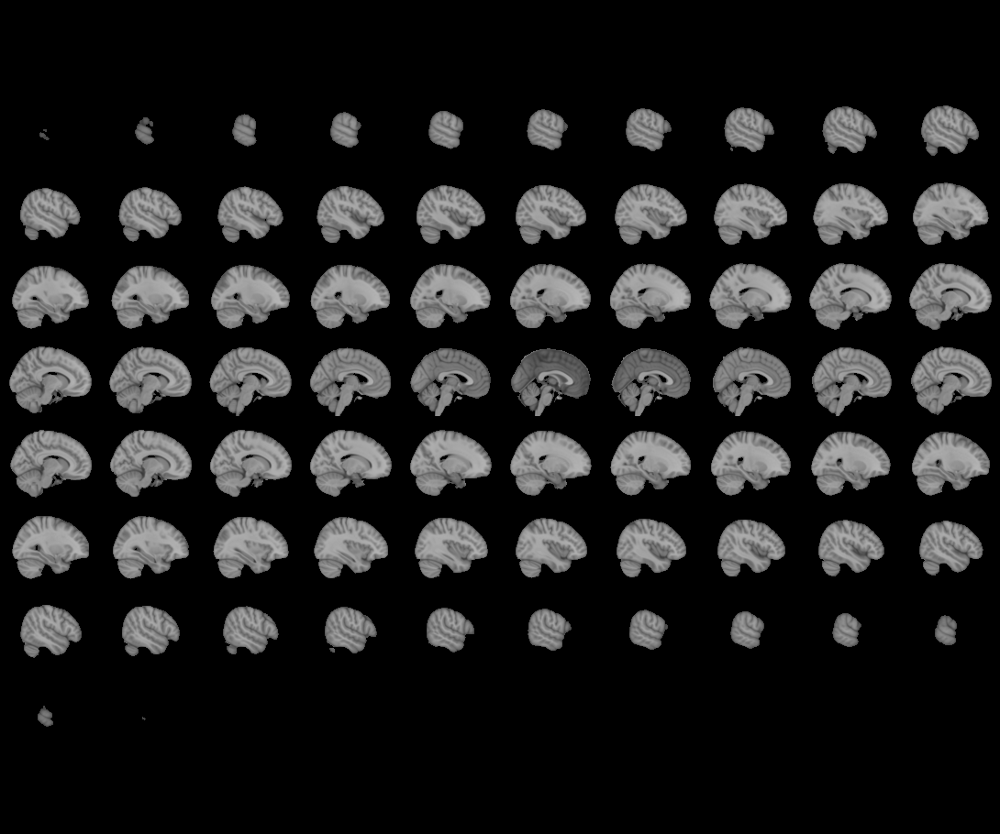
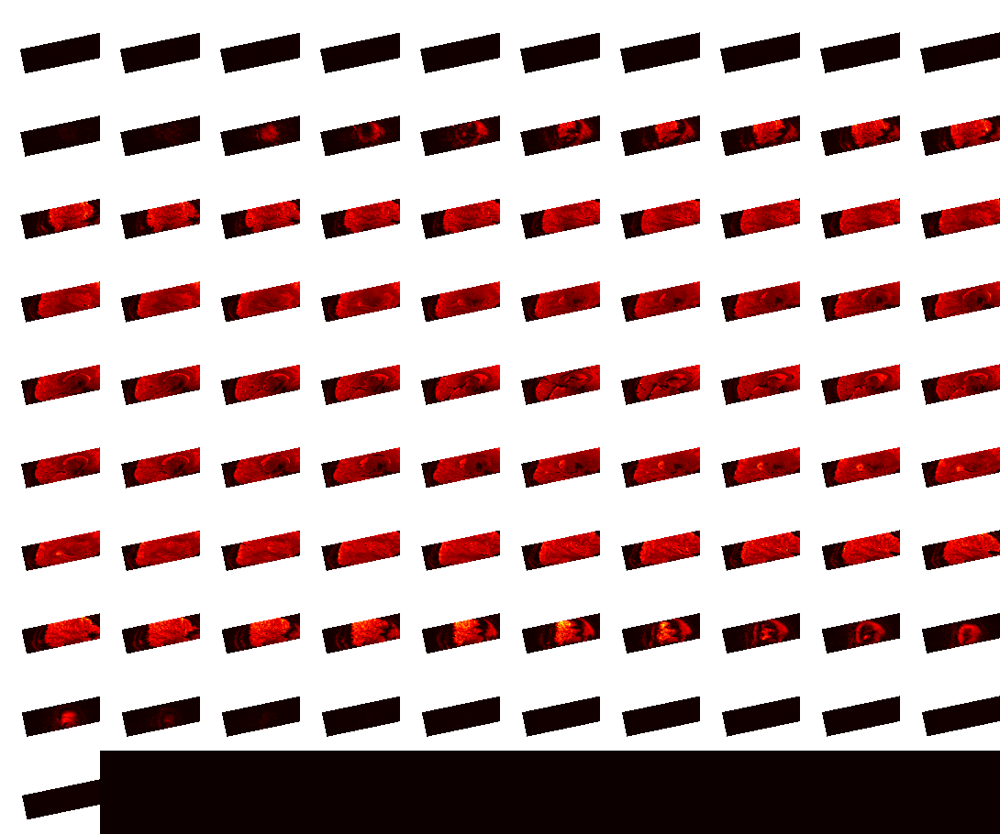

In [37]:
#  example = image.index_img(what_to_load, 0)
# plotting.view_img(example, bg_img=None)
plotting.view_img(example)

/home/marcel/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:513: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/marcel/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:513: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/marcel/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:513: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/marcel/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:513: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (data.dtype.name, aux))
/home/marcel/miniconda3/lib/python3.7/site-packages/nilearn/image/resampling.py:513: UserWarning: Casting data from int32 to float32
  warnings.warn("Casting data from %s to %s" % (dat

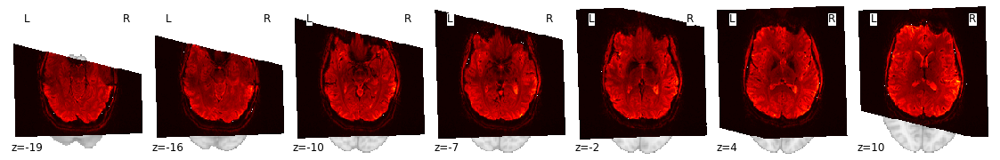

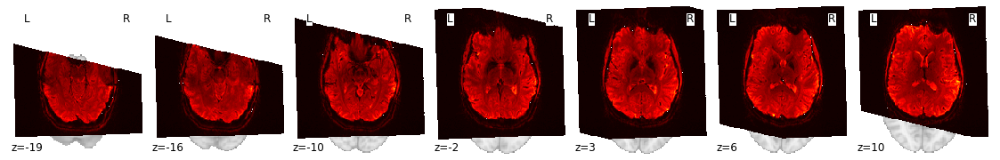

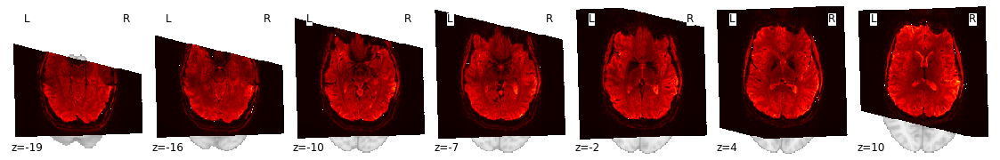

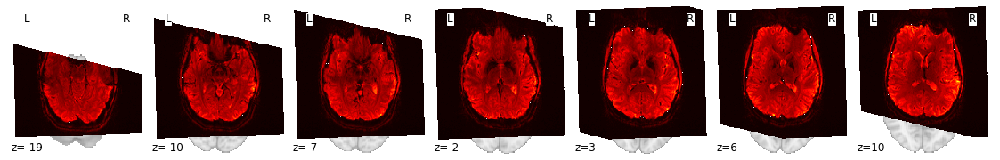

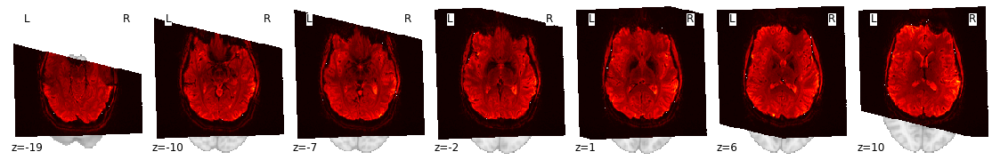

...

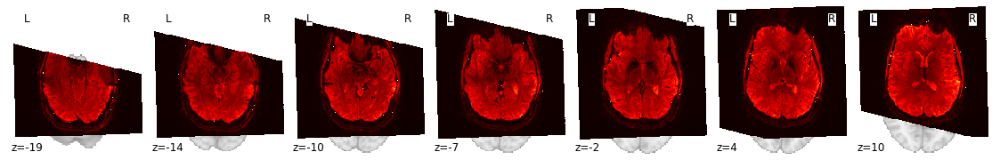

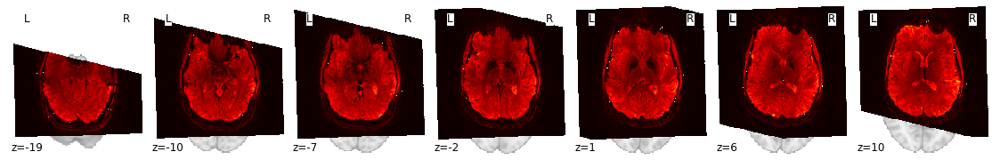

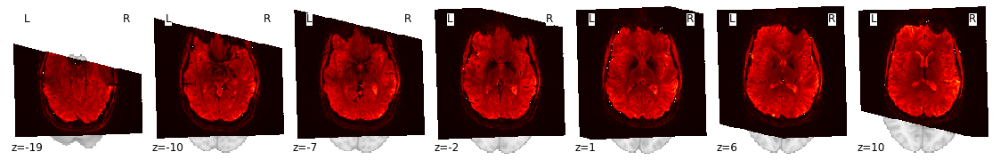

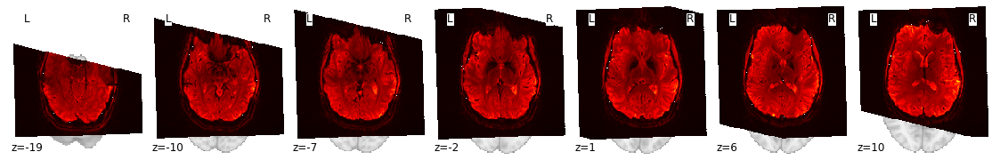

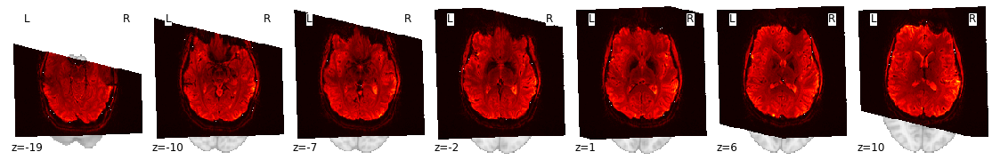

In [32]:
for img in image.iter_img(res.outputs.bolds[0]):
    # img is now an in-memory 3D img
    plotting.plot_stat_map(img, threshold=3, display_mode="z",
                           colorbar=False)

# Extract data using bids BIDSLayout

In [6]:
# Initialize the layout
layout = BIDSLayout(data_folder)

layout

BIDS Layout: ...Dell SSD/DBs/ds000113-download | Subjects: 11 | Sessions: 42 | Runs: 93

In [7]:
report = BIDSReport(layout)
counter = report.generate()

ValueError: invalid literal for int() with base 10: ''

In [ ]:
# Loop over the subjects and split bold data base on music stle. 





# wf = Workflow(name="getAPAllParticipants")
# wf.connect(bg_all, "bolds", analyzeBOLD, "paths")
# wf.run()